In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
sns.set(color_codes = True)

# Tabulation

In [3]:
url =  'https://api.covid19india.org/states_daily.json'

In [4]:
import urllib.request

In [5]:
urllib.request.urlretrieve(url, 'data.json');

In [6]:
covid_data = pd.read_json('data.json')

In [7]:
covid_data #single column.. not what we want

,states_daily
0,"{'an': '0', 'ap': '1', 'ar': '0', 'as': '0', '..."
1,"{'an': '0', 'ap': '0', 'ar': '0', 'as': '0', '..."
2,"{'an': '0', 'ap': '0', 'ar': '0', 'as': '0', '..."
3,"{'an': '0', 'ap': '0', 'ar': '0', 'as': '0', '..."
4,"{'an': '0', 'ap': '0', 'ar': '0', 'as': '0', '..."
...,...
844,"{'an': '13', 'ap': '589', 'ar': '17', 'as': '6..."
845,"{'an': '0', 'ap': '2', 'ar': '0', 'as': '5', '..."
846,"{'an': '7', 'ap': '214', 'ar': '22', 'as': '10..."
847,"{'an': '8', 'ap': '422', 'ar': '19', 'as': '93..."


In [8]:
import json

In [9]:
with open('data.json') as f:
    data = json.load(f)
data

{'states_daily': [{'an': '0',
   'ap': '1',
   'ar': '0',
   'as': '0',
   'br': '0',
   'ch': '0',
   'ct': '0',
   'date': '14-Mar-20',
   'dateymd': '2020-03-14',
   'dd': '0',
   'dl': '7',
   'dn': '0',
   'ga': '0',
   'gj': '0',
   'hp': '0',
   'hr': '14',
   'jh': '0',
   'jk': '2',
   'ka': '6',
   'kl': '19',
   'la': '0',
   'ld': '0',
   'mh': '14',
   'ml': '0',
   'mn': '0',
   'mp': '0',
   'mz': '0',
   'nl': '0',
   'or': '0',
   'pb': '1',
   'py': '0',
   'rj': '3',
   'sk': '0',
   'status': 'Confirmed',
   'tg': '1',
   'tn': '1',
   'tr': '0',
   'tt': '81',
   'un': '0',
   'up': '12',
   'ut': '0',
   'wb': '0'},
  {'an': '0',
   'ap': '0',
   'ar': '0',
   'as': '0',
   'br': '0',
   'ch': '0',
   'ct': '0',
   'date': '14-Mar-20',
   'dateymd': '2020-03-14',
   'dd': '0',
   'dl': '1',
   'dn': '0',
   'ga': '0',
   'gj': '0',
   'hp': '0',
   'hr': '0',
   'jh': '0',
   'jk': '0',
   'ka': '0',
   'kl': '3',
   'la': '0',
   'ld': '0',
   'mh': '0',
   'ml':

In [10]:
data = data['states_daily']

In [11]:
covid_data = pd.json_normalize(data)

In [12]:
covid_data

,an,ap,ar,as,br,ch,ct,date,dateymd,dd,...,sk,status,tg,tn,tr,tt,un,up,ut,wb
0,0,1,0,0,0,0,0,14-Mar-20,2020-03-14,0,...,0,Confirmed,1,1,0,81,0,12,0,0
1,0,0,0,0,0,0,0,14-Mar-20,2020-03-14,0,...,0,Recovered,0,0,0,9,0,4,0,0
2,0,0,0,0,0,0,0,14-Mar-20,2020-03-14,0,...,0,Deceased,0,0,0,2,0,0,0,0
3,0,0,0,0,0,0,0,15-Mar-20,2020-03-15,0,...,0,Confirmed,2,0,0,27,0,1,0,0
4,0,0,0,0,0,0,0,15-Mar-20,2020-03-15,0,...,0,Recovered,1,0,0,4,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
844,13,589,17,64,584,84,1426,20-Dec-20,2020-12-20,0,...,38,Recovered,643,1198,31,25734,0,1559,347,2627
845,0,2,0,5,5,2,9,20-Dec-20,2020-12-20,0,...,1,Deceased,3,15,0,332,0,19,5,40
846,7,214,22,101,287,55,1258,21-Dec-20,2020-12-21,0,...,3,Confirmed,316,1071,8,19147,0,990,448,1515
847,8,422,19,93,443,101,1738,21-Dec-20,2020-12-21,0,...,17,Recovered,612,1157,29,30250,0,1397,1013,2342


In [13]:
df = covid_data

In [14]:
df.date = pd.to_datetime(df.date)

In [15]:
df = df[df.status == 'Confirmed']

In [16]:
df.drop('status', axis=1, inplace=True)

In [17]:
df.set_index('date', inplace=True)

In [22]:
df.drop('dateymd', axis =1,inplace=True)

In [45]:
df

,an,ap,ar,as,br,ch,ct,dd,dl,dn,...,py,rj,sk,tg,tn,tr,tt,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,
2020-03-14,0,1,0,0,0,0,0,0,7,0,...,0,3,0,1,1,0,81,12,0,0
2020-03-15,0,0,0,0,0,0,0,0,0,0,...,0,1,0,2,0,0,27,1,0,0
2020-03-16,0,0,0,0,0,0,0,0,0,0,...,1,0,0,1,0,0,15,0,1,0
2020-03-17,0,0,0,0,0,0,0,0,1,0,...,0,0,0,1,0,0,11,2,0,1
2020-03-18,0,0,0,0,0,0,0,0,2,0,...,0,3,0,8,1,0,37,2,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-17,10,534,29,106,588,62,1584,0,1363,1,...,40,1122,8,509,1174,17,26754,1528,620,2245
2020-12-18,9,458,8,102,535,74,1413,0,1418,1,...,48,1076,33,551,1134,21,26991,1405,580,2239
2020-12-19,6,479,18,96,712,65,1368,0,1139,1,...,45,989,122,627,1127,26,26834,1205,584,2155


In [24]:
df.info() #dType is Object but we want it to be int

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 283 entries, 2020-03-14 to 2020-12-21
Data columns (total 39 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   an      283 non-null    object
 1   ap      283 non-null    object
 2   ar      283 non-null    object
 3   as      283 non-null    object
 4   br      283 non-null    object
 5   ch      283 non-null    object
 6   ct      283 non-null    object
 7   dd      283 non-null    object
 8   dl      283 non-null    object
 9   dn      283 non-null    object
 10  ga      283 non-null    object
 11  gj      283 non-null    object
 12  hp      283 non-null    object
 13  hr      283 non-null    object
 14  jh      283 non-null    object
 15  jk      283 non-null    object
 16  ka      283 non-null    object
 17  kl      283 non-null    object
 18  la      283 non-null    object
 19  ld      283 non-null    object
 20  mh      283 non-null    object
 21  ml      283 non-null    object
 22  mn     

In [25]:
df = df.apply(pd.to_numeric)

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 283 entries, 2020-03-14 to 2020-12-21
Data columns (total 39 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   an      283 non-null    int64
 1   ap      283 non-null    int64
 2   ar      283 non-null    int64
 3   as      283 non-null    int64
 4   br      283 non-null    int64
 5   ch      283 non-null    int64
 6   ct      283 non-null    int64
 7   dd      283 non-null    int64
 8   dl      283 non-null    int64
 9   dn      283 non-null    int64
 10  ga      283 non-null    int64
 11  gj      283 non-null    int64
 12  hp      283 non-null    int64
 13  hr      283 non-null    int64
 14  jh      283 non-null    int64
 15  jk      283 non-null    int64
 16  ka      283 non-null    int64
 17  kl      283 non-null    int64
 18  la      283 non-null    int64
 19  ld      283 non-null    int64
 20  mh      283 non-null    int64
 21  ml      283 non-null    int64
 22  mn      283 non-null    int64
 

In [29]:
df.tail(7)

,an,ap,ar,as,br,ch,ct,dd,dl,dn,...,rj,sk,tg,tn,tr,tt,un,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,
2020-12-15,8,500,17,142,572,62,1605,0,1617,0,...,1045,25,491,1132,9,26251,0,1336,496,2289
2020-12-16,8,478,21,97,565,67,1661,0,1547,1,...,1247,33,536,1181,24,18172,0,1199,567,2293
2020-12-17,10,534,29,106,588,62,1584,0,1363,1,...,1122,8,509,1174,17,26754,0,1528,620,2245
2020-12-18,9,458,8,102,535,74,1413,0,1418,1,...,1076,33,551,1134,21,26991,0,1405,580,2239
2020-12-19,6,479,18,96,712,65,1368,0,1139,1,...,989,122,627,1127,26,26834,0,1205,584,2155
2020-12-20,6,438,1,63,599,29,953,0,1091,0,...,978,12,592,1114,22,24622,0,1230,464,1978
2020-12-21,7,214,22,101,287,55,1258,0,803,0,...,913,3,316,1071,8,19147,0,990,448,1515


## Styling Tabulation

In [61]:
df_lastweek = df.tail(7)

In [62]:
df_lastweek.style

,an,ap,ar,as,br,ch,ct,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,tt,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,0,1617,0,92,1110,435,822,209,346,1185,5218,51,0,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,26251,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,0,1547,1,91,1160,484,807,190,332,1240,6185,21,0,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,18172,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,0,1363,1,88,1115,463,714,211,385,1236,4969,5,0,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,26754,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,0,1418,1,104,1075,482,749,274,388,1222,5456,9,0,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,26991,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,0,1139,1,127,1026,385,590,247,301,1152,6293,18,0,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,26834,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,0,1091,0,88,1010,319,577,172,257,1194,5711,9,0,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,24622,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,0,803,0,79,960,294,553,173,232,772,3423,7,0,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,19147,990,448,1515


In [63]:
def colour_red_negative(x):
    color = 'red' if x < 0 else 'white'
    return 'color: '+ color

In [64]:
df_lastweek.style.applymap(colour_red_negative)

,an,ap,ar,as,br,ch,ct,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,tt,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,0,1617,0,92,1110,435,822,209,346,1185,5218,51,0,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,26251,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,0,1547,1,91,1160,484,807,190,332,1240,6185,21,0,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,18172,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,0,1363,1,88,1115,463,714,211,385,1236,4969,5,0,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,26754,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,0,1418,1,104,1075,482,749,274,388,1222,5456,9,0,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,26991,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,0,1139,1,127,1026,385,590,247,301,1152,6293,18,0,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,26834,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,0,1091,0,88,1010,319,577,172,257,1194,5711,9,0,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,24622,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,0,803,0,79,960,294,553,173,232,772,3423,7,0,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,19147,990,448,1515


In [65]:
df_lastweek.drop('un', axis=1, inplace=True)

KeyError: "['un'] not found in axis"

In [66]:
df_lastweek

,an,ap,ar,as,br,ch,ct,dd,dl,dn,...,py,rj,sk,tg,tn,tr,tt,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,
2020-12-15,8,500,17,142,572,62,1605,0,1617,0,...,37,1045,25,491,1132,9,26251,1336,496,2289
2020-12-16,8,478,21,97,565,67,1661,0,1547,1,...,32,1247,33,536,1181,24,18172,1199,567,2293
2020-12-17,10,534,29,106,588,62,1584,0,1363,1,...,40,1122,8,509,1174,17,26754,1528,620,2245
2020-12-18,9,458,8,102,535,74,1413,0,1418,1,...,48,1076,33,551,1134,21,26991,1405,580,2239
2020-12-19,6,479,18,96,712,65,1368,0,1139,1,...,45,989,122,627,1127,26,26834,1205,584,2155
2020-12-20,6,438,1,63,599,29,953,0,1091,0,...,33,978,12,592,1114,22,24622,1230,464,1978
2020-12-21,7,214,22,101,287,55,1258,0,803,0,...,14,913,3,316,1071,8,19147,990,448,1515


In [47]:
df_lastweek.style.highlight_max(color='Red')

,an,ap,ar,as,br,ch,ct,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,tt,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,0,1617,0,92,1110,435,822,209,346,1185,5218,51,0,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,26251,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,0,1547,1,91,1160,484,807,190,332,1240,6185,21,0,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,18172,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,0,1363,1,88,1115,463,714,211,385,1236,4969,5,0,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,26754,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,0,1418,1,104,1075,482,749,274,388,1222,5456,9,0,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,26991,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,0,1139,1,127,1026,385,590,247,301,1152,6293,18,0,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,26834,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,0,1091,0,88,1010,319,577,172,257,1194,5711,9,0,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,24622,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,0,803,0,79,960,294,553,173,232,772,3423,7,0,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,19147,990,448,1515


In [48]:
df_lastweek.drop(['dd','ld'], axis=1,inplace=True )

In [50]:
df_lastweek.style.highlight_max(color='Red').highlight_min(color='green')

,an,ap,ar,as,br,ch,ct,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,tt,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,1617,0,92,1110,435,822,209,346,1185,5218,51,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,26251,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,1547,1,91,1160,484,807,190,332,1240,6185,21,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,18172,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,1363,1,88,1115,463,714,211,385,1236,4969,5,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,26754,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,1418,1,104,1075,482,749,274,388,1222,5456,9,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,26991,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,1139,1,127,1026,385,590,247,301,1152,6293,18,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,26834,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,1091,0,88,1010,319,577,172,257,1194,5711,9,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,24622,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,803,0,79,960,294,553,173,232,772,3423,7,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,19147,990,448,1515


In [69]:
df_lastweek.drop('tt',axis=1,inplace=True)

In [70]:
def colour_column(x): #x is a column
    is_max = (x == x.max())
    return ['font-weight: bold' if y else '' for y in is_max]

In [71]:
df_lastweek.style.apply(colour_column)

,an,ap,ar,as,br,ch,ct,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,0,1617,0,92,1110,435,822,209,346,1185,5218,51,0,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,0,1547,1,91,1160,484,807,190,332,1240,6185,21,0,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,0,1363,1,88,1115,463,714,211,385,1236,4969,5,0,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,0,1418,1,104,1075,482,749,274,388,1222,5456,9,0,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,0,1139,1,127,1026,385,590,247,301,1152,6293,18,0,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,0,1091,0,88,1010,319,577,172,257,1194,5711,9,0,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,0,803,0,79,960,294,553,173,232,772,3423,7,0,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,990,448,1515


In [72]:
df_lastweek.style.highlight_max(color='red',axis=1).apply(colour_column)

,an,ap,ar,as,br,ch,ct,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,0,1617,0,92,1110,435,822,209,346,1185,5218,51,0,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,0,1547,1,91,1160,484,807,190,332,1240,6185,21,0,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,0,1363,1,88,1115,463,714,211,385,1236,4969,5,0,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,0,1418,1,104,1075,482,749,274,388,1222,5456,9,0,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,0,1139,1,127,1026,385,590,247,301,1152,6293,18,0,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,0,1091,0,88,1010,319,577,172,257,1194,5711,9,0,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,0,803,0,79,960,294,553,173,232,772,3423,7,0,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,990,448,1515


In [75]:
df_lastweek.style.background_gradient(cmap='Purples')

,an,ap,ar,as,br,ch,ct,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,0,1617,0,92,1110,435,822,209,346,1185,5218,51,0,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,0,1547,1,91,1160,484,807,190,332,1240,6185,21,0,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,0,1363,1,88,1115,463,714,211,385,1236,4969,5,0,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,0,1418,1,104,1075,482,749,274,388,1222,5456,9,0,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,0,1139,1,127,1026,385,590,247,301,1152,6293,18,0,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,0,1091,0,88,1010,319,577,172,257,1194,5711,9,0,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,0,803,0,79,960,294,553,173,232,772,3423,7,0,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,990,448,1515


In [76]:
df_lastweek.style.background_gradient(cmap='Purples', axis=1)

,an,ap,ar,as,br,ch,ct,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,0,1617,0,92,1110,435,822,209,346,1185,5218,51,0,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,0,1547,1,91,1160,484,807,190,332,1240,6185,21,0,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,0,1363,1,88,1115,463,714,211,385,1236,4969,5,0,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,0,1418,1,104,1075,482,749,274,388,1222,5456,9,0,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,0,1139,1,127,1026,385,590,247,301,1152,6293,18,0,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,0,1091,0,88,1010,319,577,172,257,1194,5711,9,0,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,0,803,0,79,960,294,553,173,232,772,3423,7,0,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,990,448,1515


In [77]:
df_lastweek.style.background_gradient(cmap='Purples', axis=1, subset=['mh','kl','dl','ka'])

,an,ap,ar,as,br,ch,ct,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,0,1617,0,92,1110,435,822,209,346,1185,5218,51,0,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,0,1547,1,91,1160,484,807,190,332,1240,6185,21,0,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,0,1363,1,88,1115,463,714,211,385,1236,4969,5,0,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,0,1418,1,104,1075,482,749,274,388,1222,5456,9,0,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,0,1139,1,127,1026,385,590,247,301,1152,6293,18,0,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,0,1091,0,88,1010,319,577,172,257,1194,5711,9,0,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,0,803,0,79,960,294,553,173,232,772,3423,7,0,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,990,448,1515


In [81]:
df_lastweek.style.bar( subset=['mh','kl','dl','ka'])

,an,ap,ar,as,br,ch,ct,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,tg,tn,tr,up,ut,wb
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-12-15 00:00:00,8,500,17,142,572,62,1605,0,1617,0,92,1110,435,822,209,346,1185,5218,51,0,3442,66,83,1073,9,33,300,394,37,1045,25,491,1132,9,1336,496,2289
2020-12-16 00:00:00,8,478,21,97,565,67,1661,0,1547,1,91,1160,484,807,190,332,1240,6185,21,0,-5914,65,81,1079,31,26,407,330,32,1247,33,536,1181,24,1199,567,2293
2020-12-17 00:00:00,10,534,29,106,588,62,1584,0,1363,1,88,1115,463,714,211,385,1236,4969,5,0,3880,69,81,1161,5,33,351,448,40,1122,8,509,1174,17,1528,620,2245
2020-12-18 00:00:00,9,458,8,102,535,74,1413,0,1418,1,104,1075,482,749,274,388,1222,5456,9,0,3994,48,86,1181,9,12,358,439,48,1076,33,551,1134,21,1405,580,2239
2020-12-19 00:00:00,6,479,18,96,712,65,1368,0,1139,1,127,1026,385,590,247,301,1152,6293,18,0,3940,32,58,1085,16,9,356,435,45,989,122,627,1127,26,1205,584,2155
2020-12-20 00:00:00,6,438,1,63,599,29,953,0,1091,0,88,1010,319,577,172,257,1194,5711,9,0,3811,32,48,1069,12,1,372,337,33,978,12,592,1114,22,1230,464,1978
2020-12-21 00:00:00,7,214,22,101,287,55,1258,0,803,0,79,960,294,553,173,232,772,3423,7,0,2834,5,38,1035,2,16,363,336,14,913,3,316,1071,8,990,448,1515


In [83]:
df_lastweek[ ['mh','kl','dl','ka']].style.bar()

,mh,kl,dl,ka
date,,,,
2020-12-15 00:00:00,3442,5218,1617,1185
2020-12-16 00:00:00,-5914,6185,1547,1240
2020-12-17 00:00:00,3880,4969,1363,1236
2020-12-18 00:00:00,3994,5456,1418,1222
2020-12-19 00:00:00,3940,6293,1139,1152
2020-12-20 00:00:00,3811,5711,1091,1194
2020-12-21 00:00:00,2834,3423,803,772


In [89]:
df_lastweek[['kl','dl','ka']].style.bar(subset='ka', color = "Purple").bar(subset='dl', color = "Green").bar(subset='kl', color = "Blue")

,kl,dl,ka
date,,,
2020-12-15 00:00:00,5218,1617,1185
2020-12-16 00:00:00,6185,1547,1240
2020-12-17 00:00:00,4969,1363,1236
2020-12-18 00:00:00,5456,1418,1222
2020-12-19 00:00:00,6293,1139,1152
2020-12-20 00:00:00,5711,1091,1194
2020-12-21 00:00:00,3423,803,772


# Distribution of data


## Distribution of a single continuous variable

### Histogram

In [4]:
x = np.random.normal(size =1000)

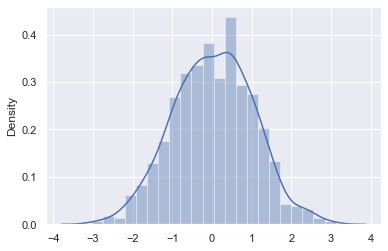

In [17]:
sns.distplot(x);

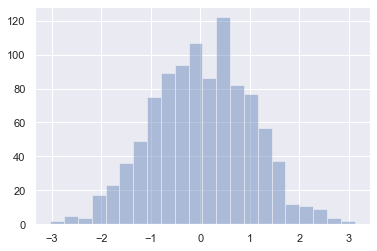

In [18]:
sns.distplot(x, kde= False);

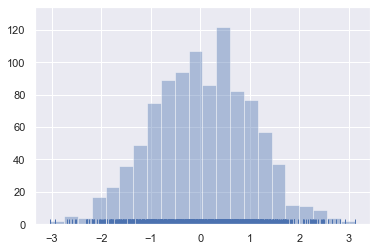

In [19]:
sns.distplot(x, kde= False, rug = True);

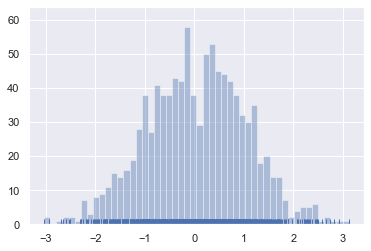

In [20]:
sns.distplot(x, kde= False, rug = True, bins= 50);

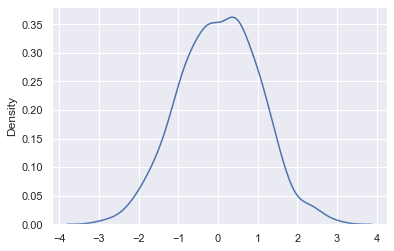

In [21]:
sns.kdeplot(x);

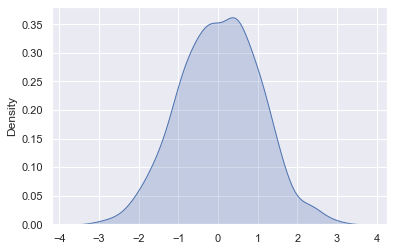

In [22]:
sns.kdeplot(x, shade=True);

In [25]:
y = np.random.uniform(size=1000)

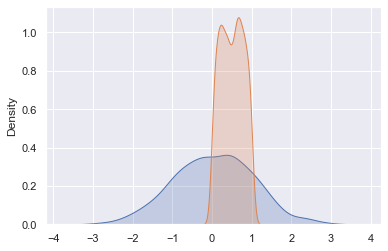

In [26]:
sns.kdeplot(x, shade=True)
sns.kdeplot(y, shade=True);


In [2]:
d = sns.load_dataset('diamonds')

In [28]:
d

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


In [29]:
d.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype   
---  ------   --------------  -----   
 0   carat    53940 non-null  float64 
 1   cut      53940 non-null  category
 2   color    53940 non-null  category
 3   clarity  53940 non-null  category
 4   depth    53940 non-null  float64 
 5   table    53940 non-null  float64 
 6   price    53940 non-null  int64   
 7   x        53940 non-null  float64 
 8   y        53940 non-null  float64 
 9   z        53940 non-null  float64 
dtypes: category(3), float64(6), int64(1)
memory usage: 3.0 MB


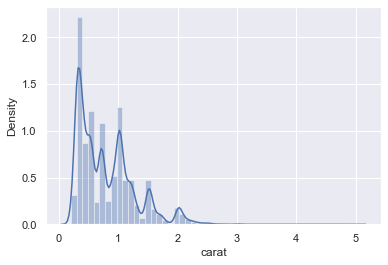

In [32]:
sns.distplot(d.carat);

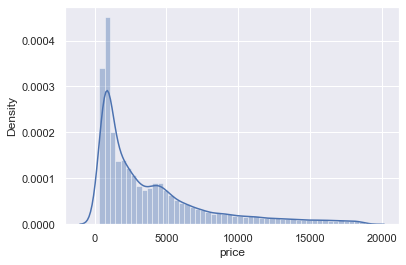

In [34]:
sns.distplot(d.price);

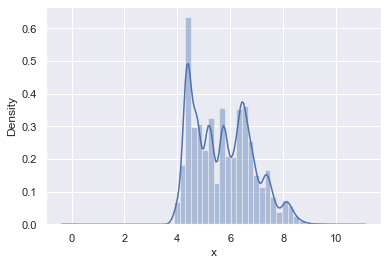

In [35]:
sns.distplot(d.x);

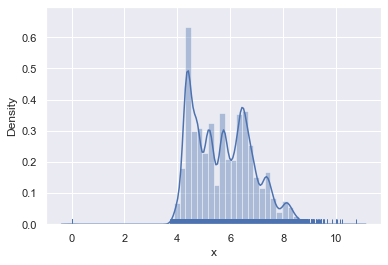

In [36]:
sns.distplot(d.x, rug=True);

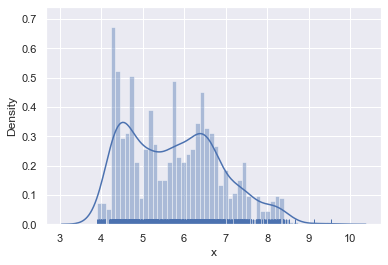

In [40]:
sns.distplot(d.sample(1000).x, rug=True, bins = 50);

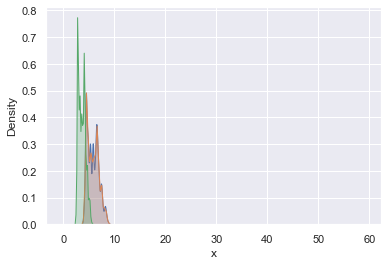

In [41]:
sns.kdeplot(d.x, shade=True)
sns.kdeplot(d.y, shade=True)
sns.kdeplot(d.z, shade=True);

### Box Plot

In [42]:
x = np.random.normal(size=1000) 

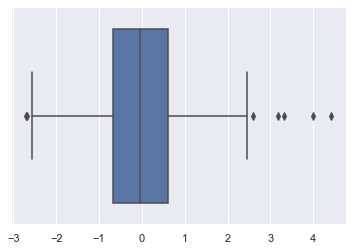

In [43]:
sns.boxplot(x);

In [44]:
y = np.random.uniform(size=1000)

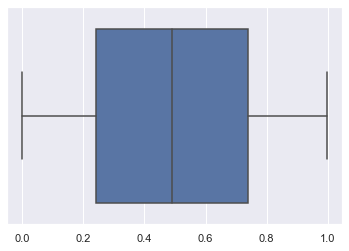

In [45]:
sns.boxplot(y);


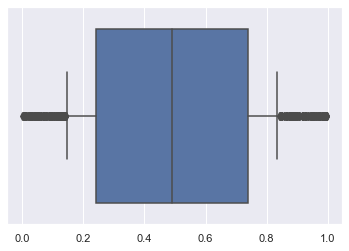

In [46]:
sns.boxplot(y, whis=0.2);

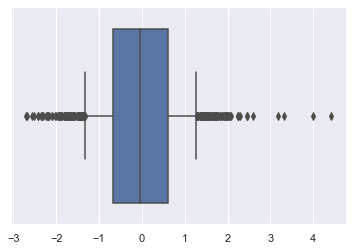

In [48]:
sns.boxplot(x, whis=0.5);

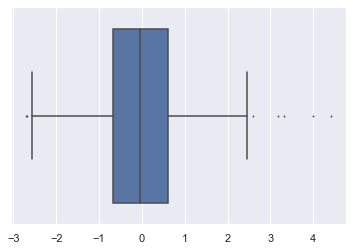

In [74]:
sns.boxplot(x,orient='v',fliersize=1);

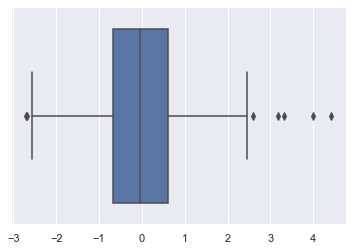

In [75]:
sns.boxplot(x,orient='v');

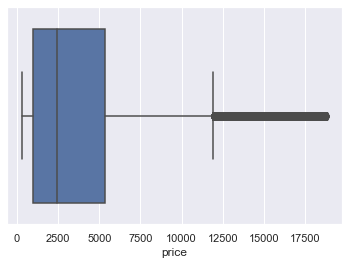

In [6]:
sns.boxplot(d.price);

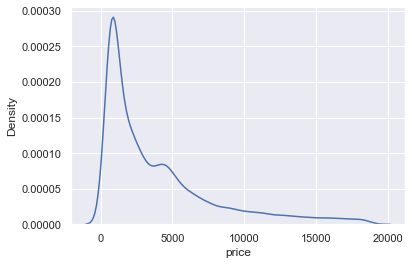

In [7]:
sns.kdeplot(d.price);

<AxesSubplot:xlabel='x'>

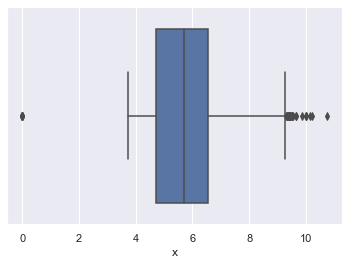

In [8]:
sns.boxplot(d.x)

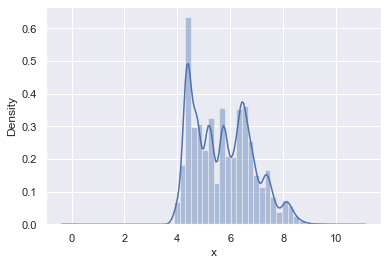

In [11]:
sns.distplot(d.x);

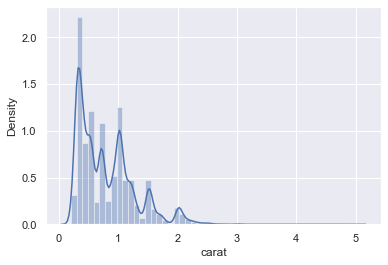

In [13]:
sns.distplot(d.carat);

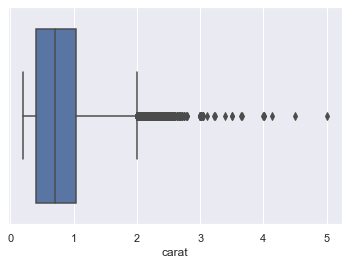

In [14]:
sns.boxplot(d.carat);

### Boxen plots

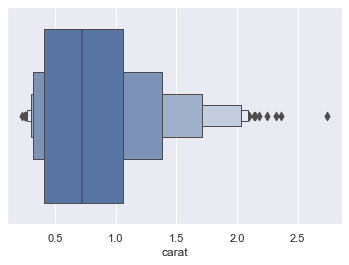

In [127]:
sns.boxenplot(d.sample(500).carat);

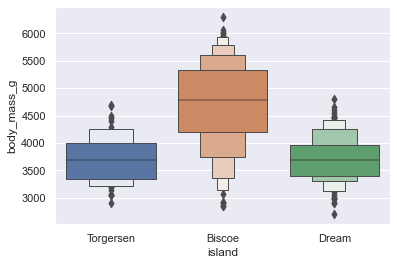

In [128]:
sns.boxenplot(x='island', y = 'body_mass_g', data = p);

## Distribution of a categorical variable

### Bar Plot

In [19]:
c = d.groupby('cut')['cut'].count()

<AxesSubplot:xlabel='cut'>

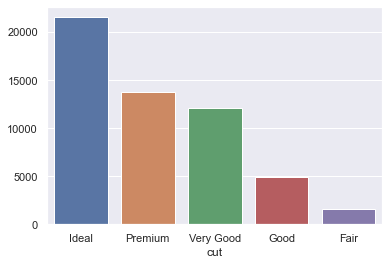

In [20]:
sns.barplot(x=c.index, y = c.values)

In [21]:
c = d.groupby('clarity')['clarity'].count()

<AxesSubplot:xlabel='clarity'>

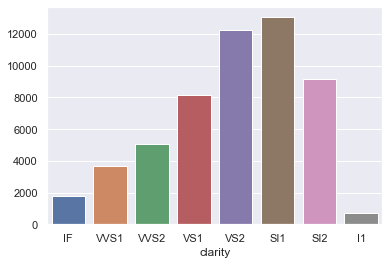

In [22]:
sns.barplot(x=c.index, y = c.values)


In [23]:
c = d.groupby('color')['color'].count()

<AxesSubplot:xlabel='color'>

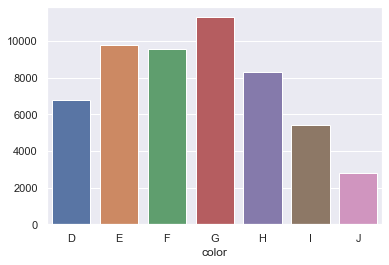

In [28]:
sns.barplot(x=c.index, y = c.values)

## Joint distribution of two variables

### Joint Plot

In [25]:
x = np.random.normal(size=1000)
y = np.random.normal(size = 1000)

In [26]:
df = pd.DataFrame({'x':x,'y':y})

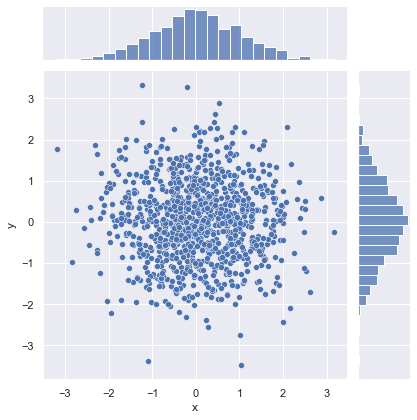

In [34]:
sns.jointplot('x','y',data = df)

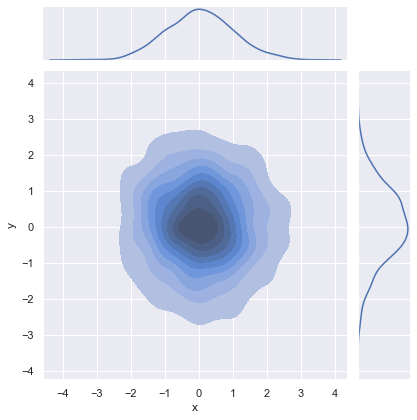

In [27]:
sns.jointplot('x','y',data = df, kind='kde', shade= True)

In [28]:
x = np.random.normal(size=1000)
y = 3*x + np.random.normal(size=1000)/5

In [29]:
df = pd.DataFrame({'x':x,'y':y})

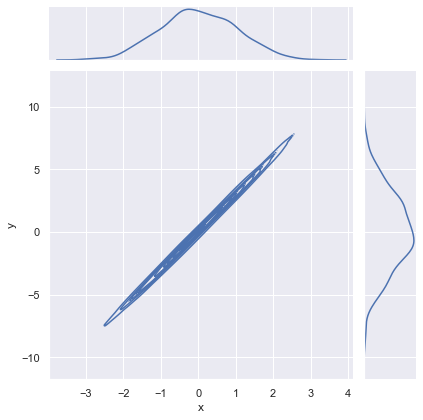

In [30]:
sns.jointplot('x','y',data = df, kind='kde')

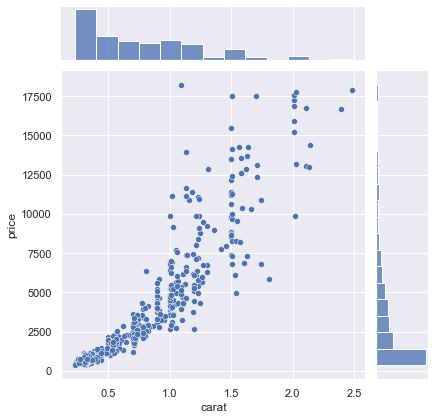

In [10]:
sns.jointplot('carat','price',data = d.sample(500))

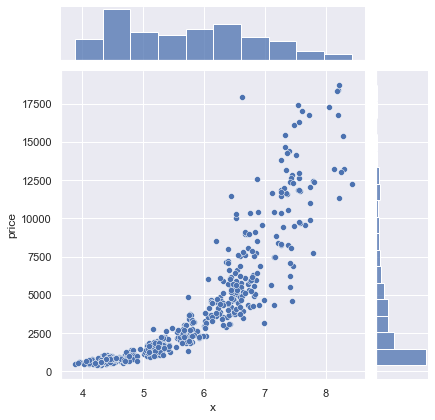

In [11]:
sns.jointplot('x','price',data = d.sample(500))

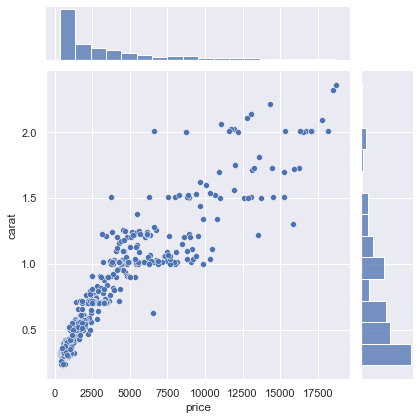

In [4]:
sns.jointplot('price', 'carat',data = d.sample(500) )

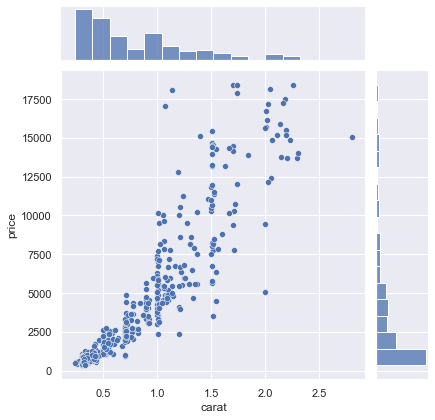

In [5]:
sns.jointplot('carat', 'price',data = d.sample(500) )

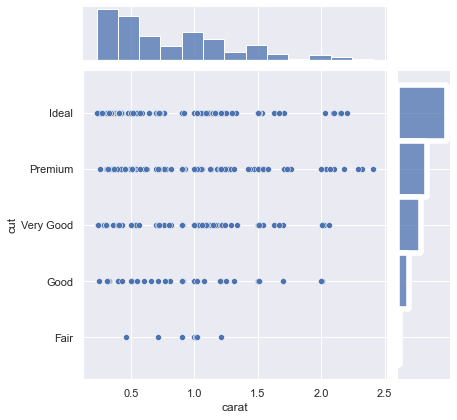

In [6]:
sns.jointplot('carat', 'cut',data = d.sample(500) )

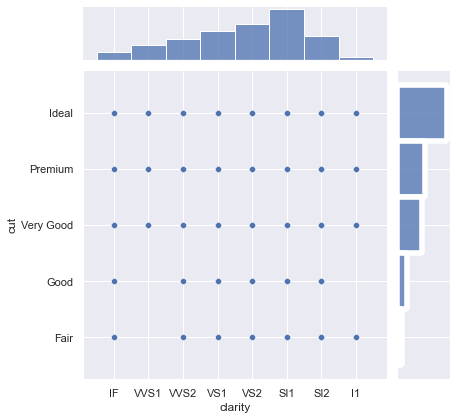

In [10]:
sns.jointplot('clarity', 'cut',data = d.sample(500) )

### Swarm Plot

<AxesSubplot:xlabel='carat'>

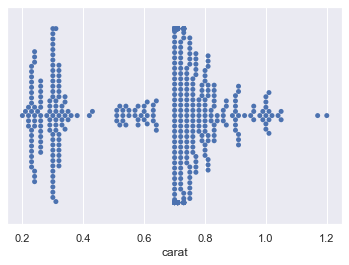

In [3]:
sns.swarmplot(d.head(500).carat)

<AxesSubplot:xlabel='price'>

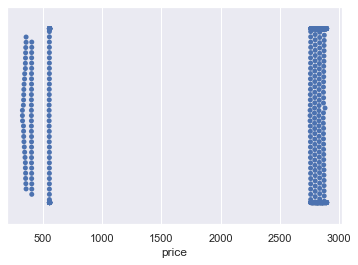

In [5]:
sns.swarmplot(d.head(1000).price)

<AxesSubplot:xlabel='price'>

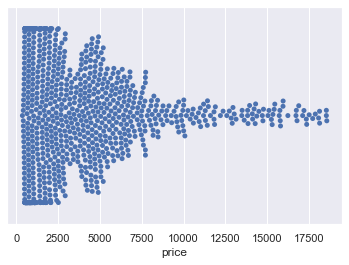

In [6]:
sns.swarmplot(d.sample(1000).price)

<AxesSubplot:xlabel='carat'>

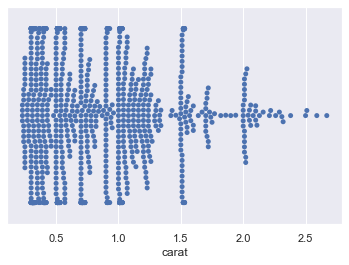

In [7]:
sns.swarmplot(d.sample(1000).carat)

In [8]:
d.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype   
---  ------   --------------  -----   
 0   carat    53940 non-null  float64 
 1   cut      53940 non-null  category
 2   color    53940 non-null  category
 3   clarity  53940 non-null  category
 4   depth    53940 non-null  float64 
 5   table    53940 non-null  float64 
 6   price    53940 non-null  int64   
 7   x        53940 non-null  float64 
 8   y        53940 non-null  float64 
 9   z        53940 non-null  float64 
dtypes: category(3), float64(6), int64(1)
memory usage: 3.0 MB


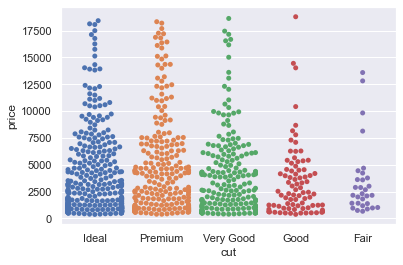

In [3]:
sns.swarmplot(x='cut',y='price',data = d.sample(1000));

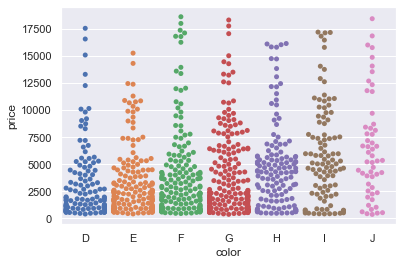

In [11]:
sns.swarmplot(x='color',y='price',data = d.sample(1000));

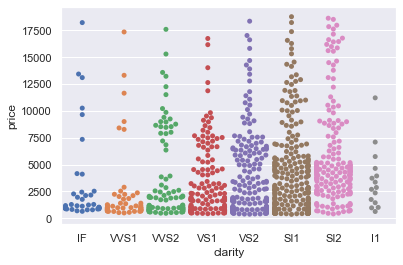

In [12]:
sns.swarmplot(y='price',x='clarity',data = d.sample(1000));

In [39]:
p = sns.load_dataset('penguins')

In [14]:
p.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 344 entries, 0 to 343
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   species            344 non-null    object 
 1   island             344 non-null    object 
 2   bill_length_mm     342 non-null    float64
 3   bill_depth_mm      342 non-null    float64
 4   flipper_length_mm  342 non-null    float64
 5   body_mass_g        342 non-null    float64
 6   sex                333 non-null    object 
dtypes: float64(4), object(3)
memory usage: 18.9+ KB


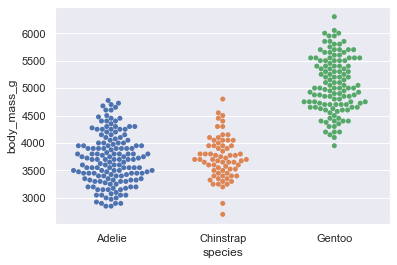

In [16]:
sns.swarmplot(x='species', y='body_mass_g', data = p);

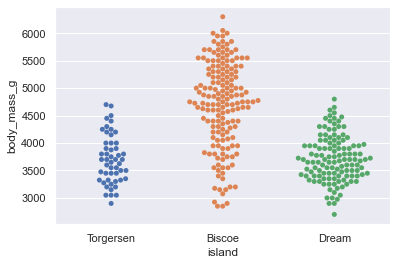

In [17]:
sns.swarmplot(x='island', y='body_mass_g', data = p);

### Violin Plot

<AxesSubplot:xlabel='body_mass_g'>

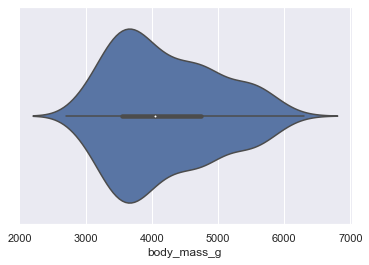

In [19]:
sns.violinplot(x='body_mass_g', data=p) #white dot - median , thicker line - iqr, thinner line - whisker, distribution

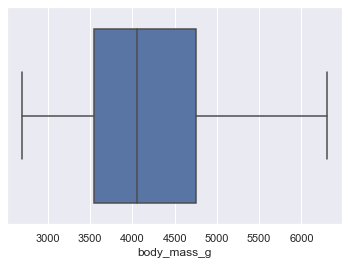

In [21]:
sns.boxplot(x='body_mass_g', data=p);

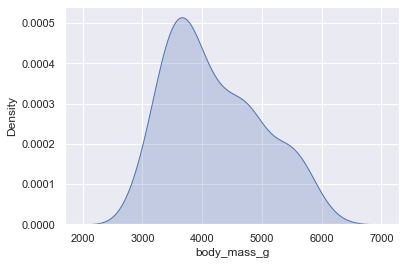

In [23]:
sns.kdeplot(x='body_mass_g', data=p, shade=True);

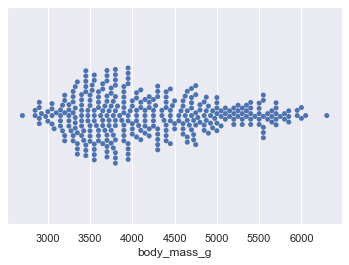

In [31]:
sns.swarmplot(x='body_mass_g', data=p);

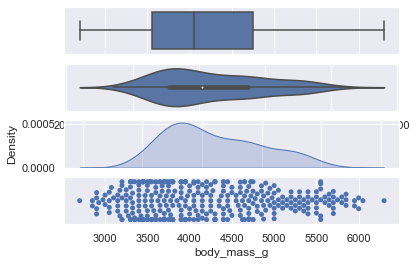

In [33]:
fig, axs = plt.subplots(nrows=4)
sns.boxplot(x='body_mass_g', data=p, ax=axs[0]);
sns.violinplot(x='body_mass_g', data=p, ax=axs[1]);
sns.kdeplot(x='body_mass_g', data=p, shade=True, ax=axs[2]);
sns.swarmplot(x='body_mass_g', data=p, ax=axs[3]);

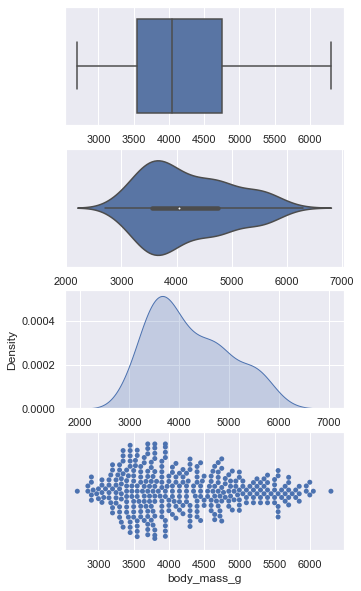

In [36]:
fig, axs = plt.subplots(nrows=4)
fig.set_size_inches(5,10)
sns.boxplot(x='body_mass_g', data=p, ax=axs[0]);
sns.violinplot(x='body_mass_g', data=p, ax=axs[1]);
sns.kdeplot(x='body_mass_g', data=p, shade=True, ax=axs[2]);
sns.swarmplot(x='body_mass_g', data=p, ax=axs[3]);

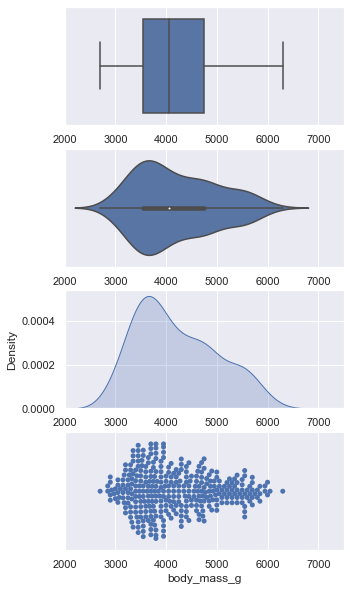

In [41]:
fig, axs = plt.subplots(nrows=4)
fig.set_size_inches(5,10)
p1 = sns.boxplot(x='body_mass_g', data=p, ax=axs[0]);
p1.set(xlim=(2000, 7500));
p2 = sns.violinplot(x='body_mass_g', data=p, ax=axs[1]);
p2.set(xlim=(2000, 7500));
p3  = sns.kdeplot(x='body_mass_g', data=p, shade=True, ax=axs[2]);
p3.set(xlim=(2000, 7500));
p4 = sns.swarmplot(x='body_mass_g', data=p, ax=axs[3]);
p4.set(xlim=(2000, 7500));

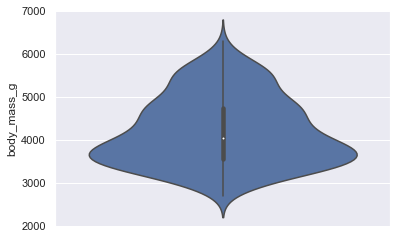

In [48]:
sns.violinplot(y='body_mass_g', data=p);

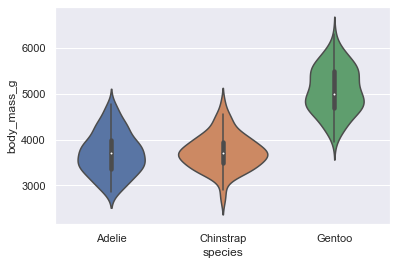

In [49]:
sns.violinplot(x = 'species',y='body_mass_g', data=p);

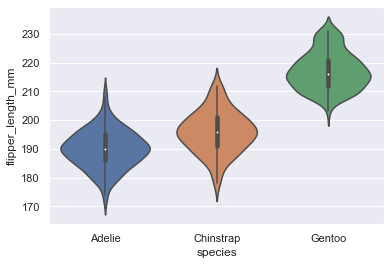

In [51]:
sns.violinplot(x = 'species',y='flipper_length_mm', data=p);

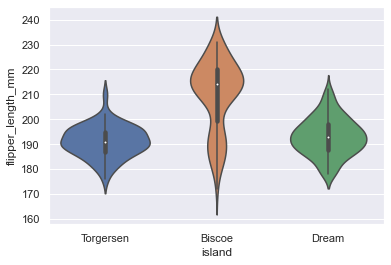

In [52]:
sns.violinplot(x = 'island',y='flipper_length_mm', data=p);

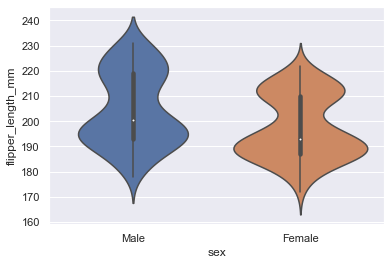

In [53]:
sns.violinplot(x = 'sex',y='flipper_length_mm', data=p);

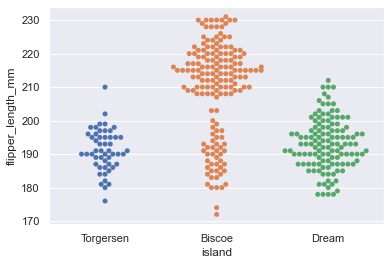

In [54]:
sns.swarmplot(x = 'island',y='flipper_length_mm', data=p);

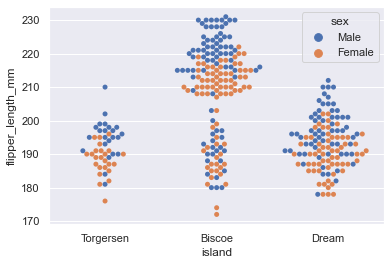

In [56]:
sns.swarmplot(x = 'island',y='flipper_length_mm',hue = 'sex', data=p);

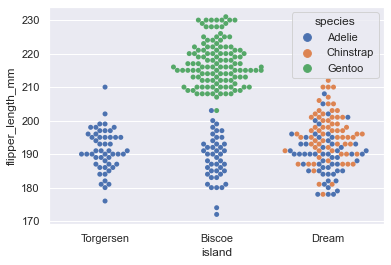

In [57]:
sns.swarmplot(x = 'island',y='flipper_length_mm',hue = 'species', data=p);

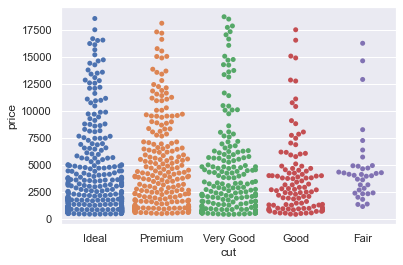

In [58]:
sns.swarmplot(x = 'cut',y='price', data=d.sample(1000));

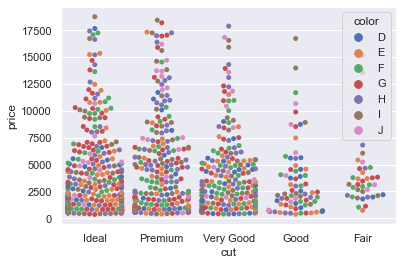

In [59]:
sns.swarmplot(x = 'cut',y='price',hue = 'color', data=d.sample(1000));

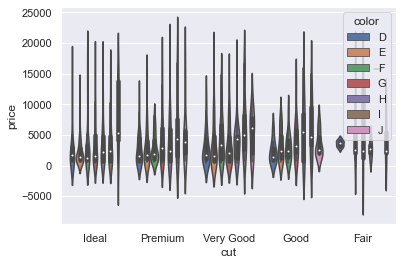

In [60]:
sns.violinplot(x = 'cut',y='price',hue = 'color', data=d.sample(1000));

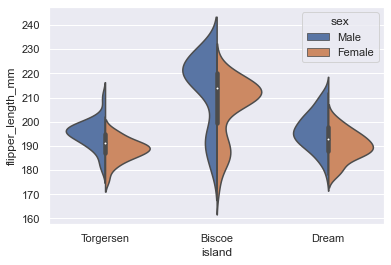

In [69]:
sns.violinplot(x = 'island',y='flipper_length_mm',hue = 'sex',split=True, data=p);

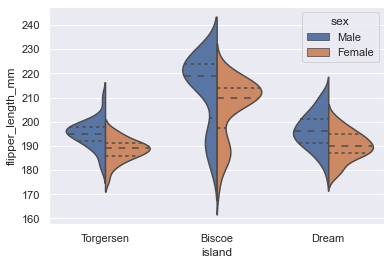

In [70]:
sns.violinplot(x = 'island',y='flipper_length_mm',hue = 'sex',split=True, inner='quartile', data=p);

In [71]:
sns.violinplot(x = 'island',y='flipper_length_mm',hue = 'species',split=True, inner='quartile', data=p); # more than 2 species

ValueError: There must be exactly two hue levels to use `split`.'

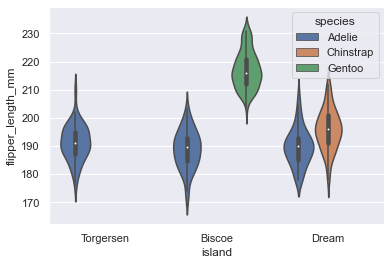

In [73]:
sns.violinplot(x = 'island',y='flipper_length_mm',hue = 'species',data=p);

In [80]:
p['binary_species'] = p.species.apply(lambda x: 'Gentoo' if x=='Gentoo' else 'Adelie|Chinstrap')

In [81]:
p

,species,island,bill_length_mm,bill_depth_mm,flipper_length_mm,body_mass_g,sex,binary_species
0,Adelie,Torgersen,39.1,18.7,181.0,3750.0,Male,Adelie|Chinstrap
1,Adelie,Torgersen,39.5,17.4,186.0,3800.0,Female,Adelie|Chinstrap
2,Adelie,Torgersen,40.3,18.0,195.0,3250.0,Female,Adelie|Chinstrap
3,Adelie,Torgersen,NaN,NaN,NaN,NaN,NaN,Adelie|Chinstrap
4,Adelie,Torgersen,36.7,19.3,193.0,3450.0,Female,Adelie|Chinstrap
...,...,...,...,...,...,...,...,...
339,Gentoo,Biscoe,NaN,NaN,NaN,NaN,NaN,Gentoo
340,Gentoo,Biscoe,46.8,14.3,215.0,4850.0,Female,Gentoo
341,Gentoo,Biscoe,50.4,15.7,222.0,5750.0,Male,Gentoo
342,Gentoo,Biscoe,45.2,14.8,212.0,5200.0,Female,Gentoo


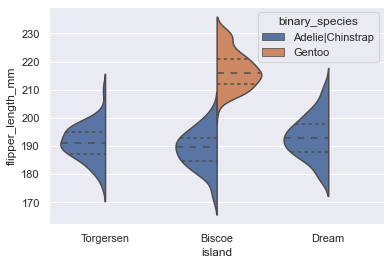

In [82]:
sns.violinplot(x = 'island',y='flipper_length_mm',hue = 'binary_species',split=True, inner='quartile', data=p);

### Faceted plotting

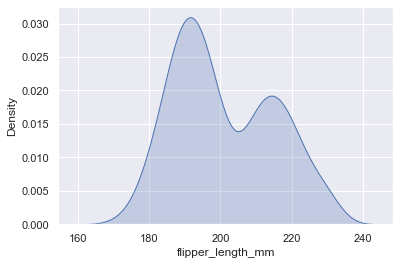

In [84]:
sns.kdeplot(p.flipper_length_mm, shade=True);

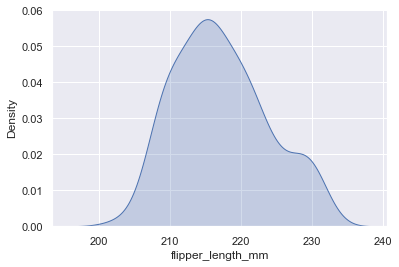

In [85]:
sns.kdeplot(p[p.species=='Gentoo'].flipper_length_mm, shade=True);

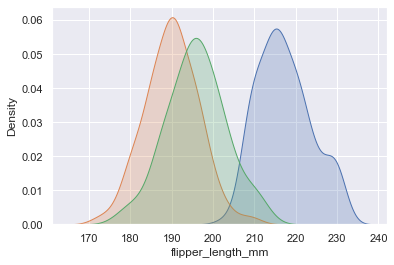

In [86]:
sns.kdeplot(p[p.species=='Gentoo'].flipper_length_mm, shade=True);
sns.kdeplot(p[p.species=='Adelie'].flipper_length_mm, shade=True);
sns.kdeplot(p[p.species=='Chinstrap'].flipper_length_mm, shade=True);

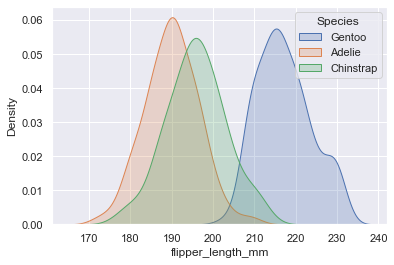

In [87]:
sns.kdeplot(p[p.species=='Gentoo'].flipper_length_mm, shade=True);
sns.kdeplot(p[p.species=='Adelie'].flipper_length_mm, shade=True);
sns.kdeplot(p[p.species=='Chinstrap'].flipper_length_mm, shade=True);
plt.legend(title='Species',labels = ['Gentoo', 'Adelie', 'Chinstrap']);

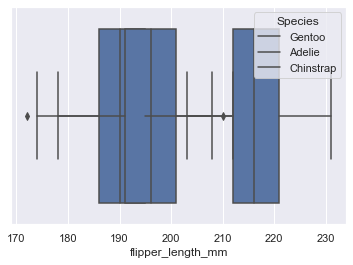

In [89]:
sns.boxplot(p[p.species=='Gentoo'].flipper_length_mm);
sns.boxplot(p[p.species=='Adelie'].flipper_length_mm);
sns.boxplot(p[p.species=='Chinstrap'].flipper_length_mm);
plt.legend(title='Species',labels = ['Gentoo', 'Adelie', 'Chinstrap']);

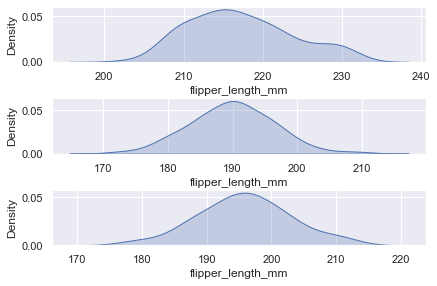

In [95]:
fig, axs = plt.subplots(nrows = 3)
plt.tight_layout()
sns.kdeplot(p[p.species=='Gentoo'].flipper_length_mm, shade=True, ax=axs[0]);
sns.kdeplot(p[p.species=='Adelie'].flipper_length_mm, shade=True,  ax=axs[1]);
sns.kdeplot(p[p.species=='Chinstrap'].flipper_length_mm, shade=True,  ax=axs[2]);
#plt.legend(title='Species',labels = ['Gentoo', 'Adelie', 'Chinstrap']);

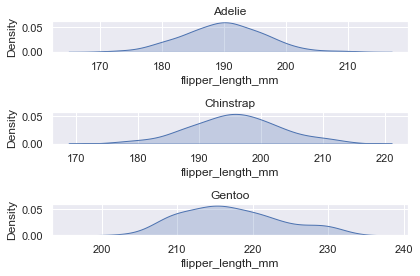

In [104]:
col_name  = 'species'
nrows = len(p[col_name].unique())
fig, axs = plt.subplots(nrows = 3)
i=0
for c_v in p[col_name].unique():
    pl=sns.kdeplot(p[p[col_name]==c_v].flipper_length_mm, shade=True, ax=axs[i]);
    pl.set_title(c_v)
    i+=1
plt.tight_layout()

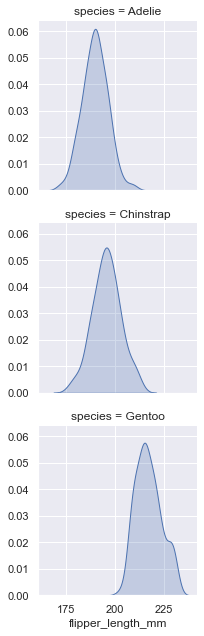

In [106]:
g = sns.FacetGrid(p, row='species');
g.map(sns.kdeplot, 'flipper_length_mm', shade=True);

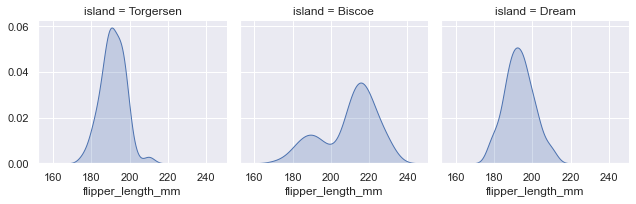

In [110]:
g = sns.FacetGrid(p, col='island');
g.map(sns.kdeplot, 'flipper_length_mm', shade=True);

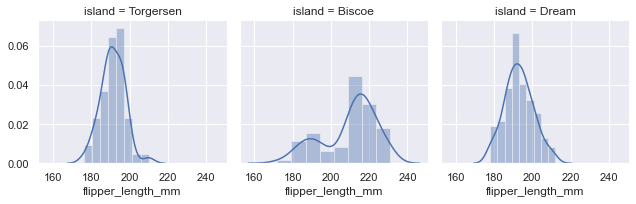

In [109]:
g = sns.FacetGrid(p, col='island');
g.map(sns.distplot, 'flipper_length_mm');

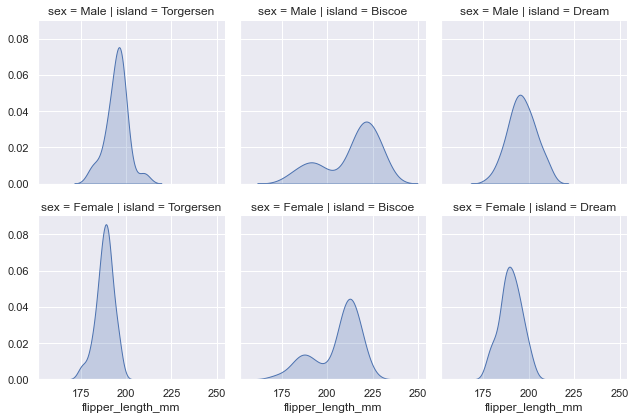

In [111]:
g = sns.FacetGrid(p, col = 'island', row='sex');
g.map(sns.kdeplot, 'flipper_length_mm', shade=True);

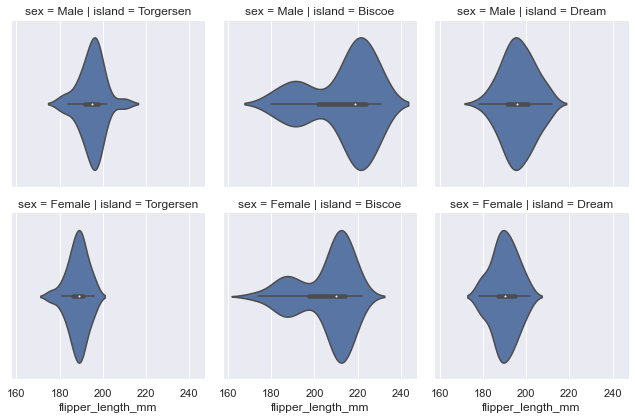

In [112]:
g = sns.FacetGrid(p, col = 'island', row='sex');
g.map(sns.violinplot, 'flipper_length_mm', shade=True);

### Pair plot

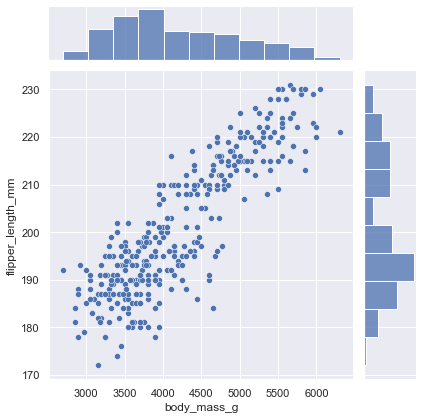

In [115]:
sns.jointplot(p.body_mass_g, p.flipper_length_mm);

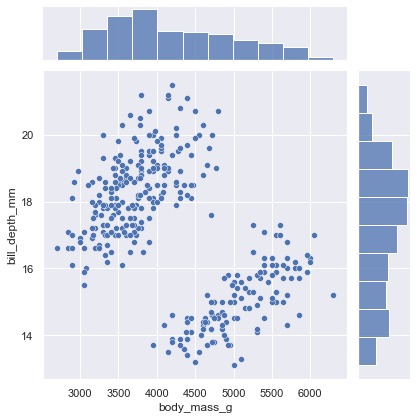

In [117]:
sns.jointplot(p.body_mass_g, p.bill_depth_mm);

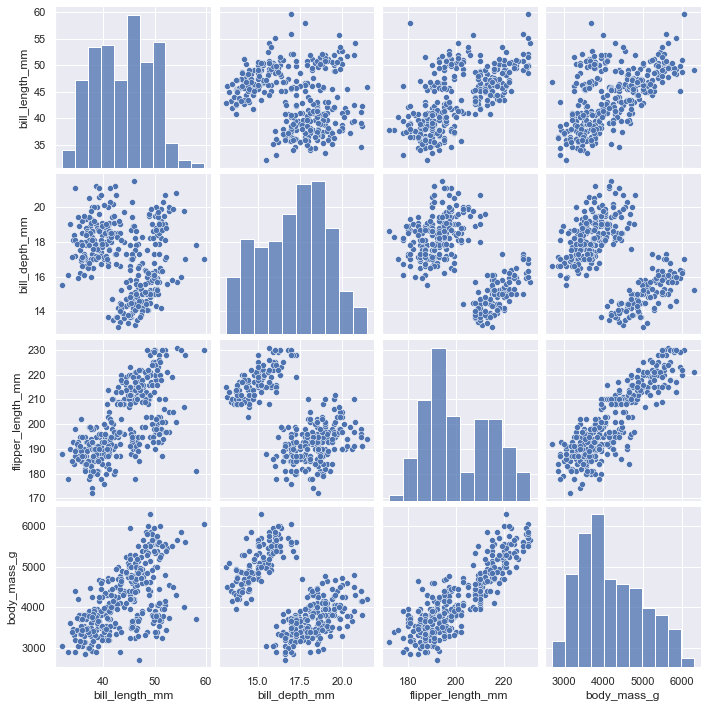

In [120]:
sns.pairplot(p)

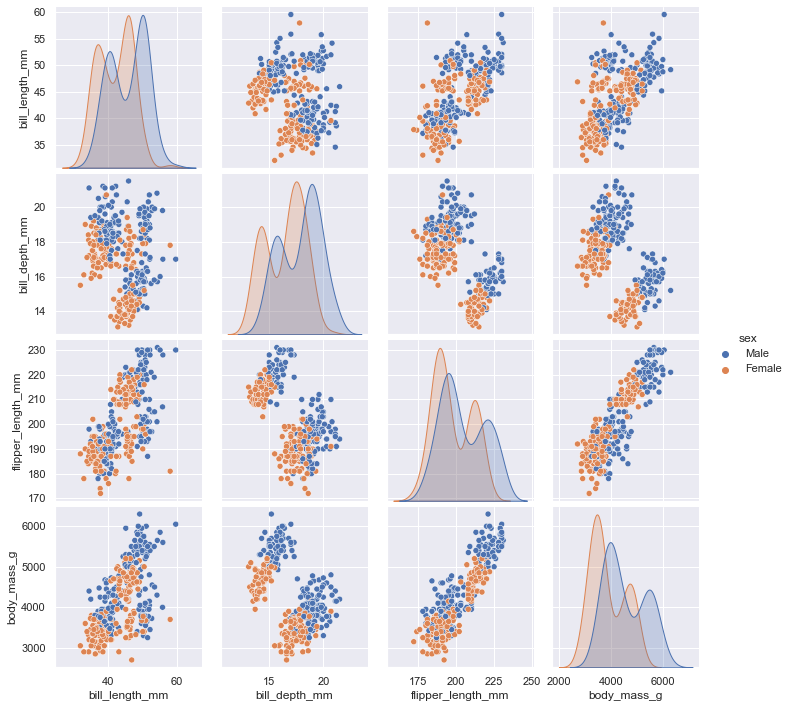

In [121]:
sns.pairplot(p, hue='sex');

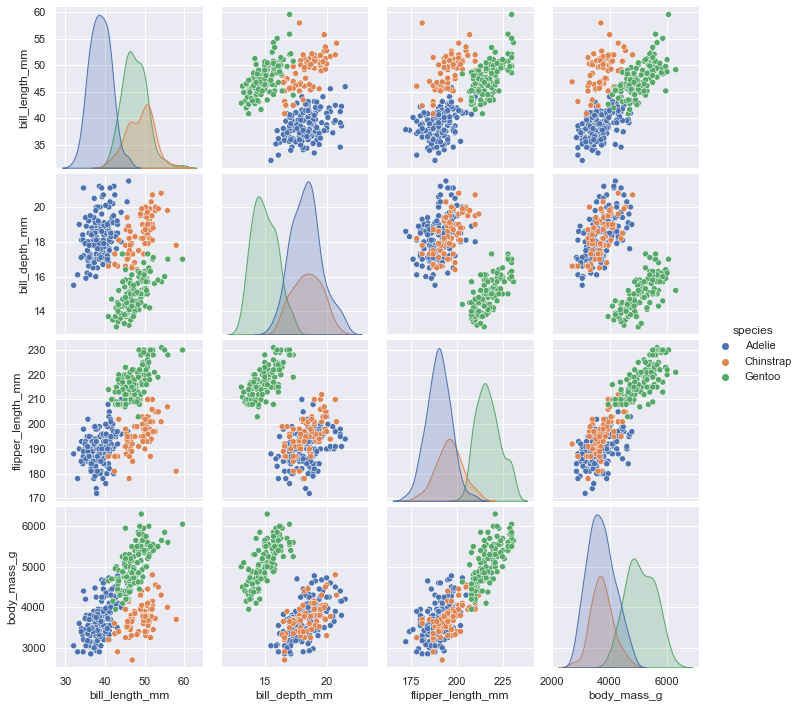

In [122]:
sns.pairplot(p, hue='species');

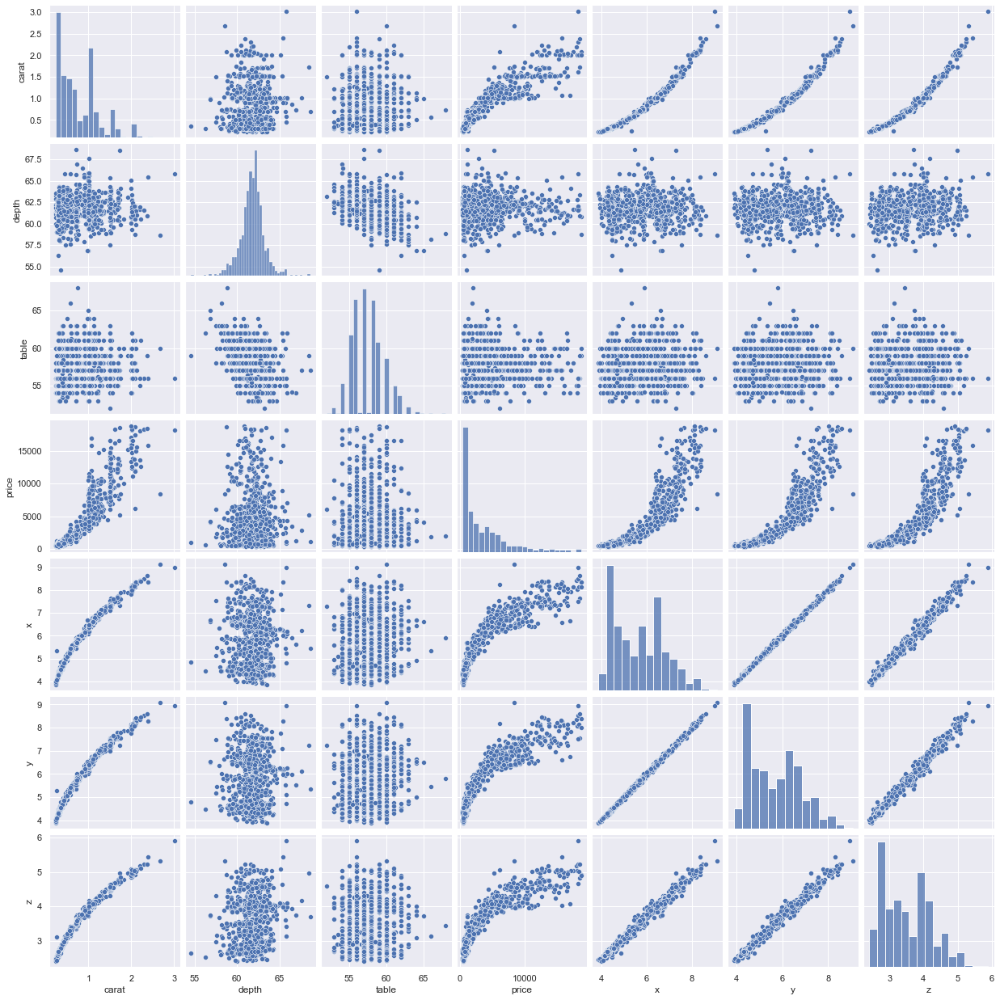

In [123]:
sns.pairplot(d.sample(1000));

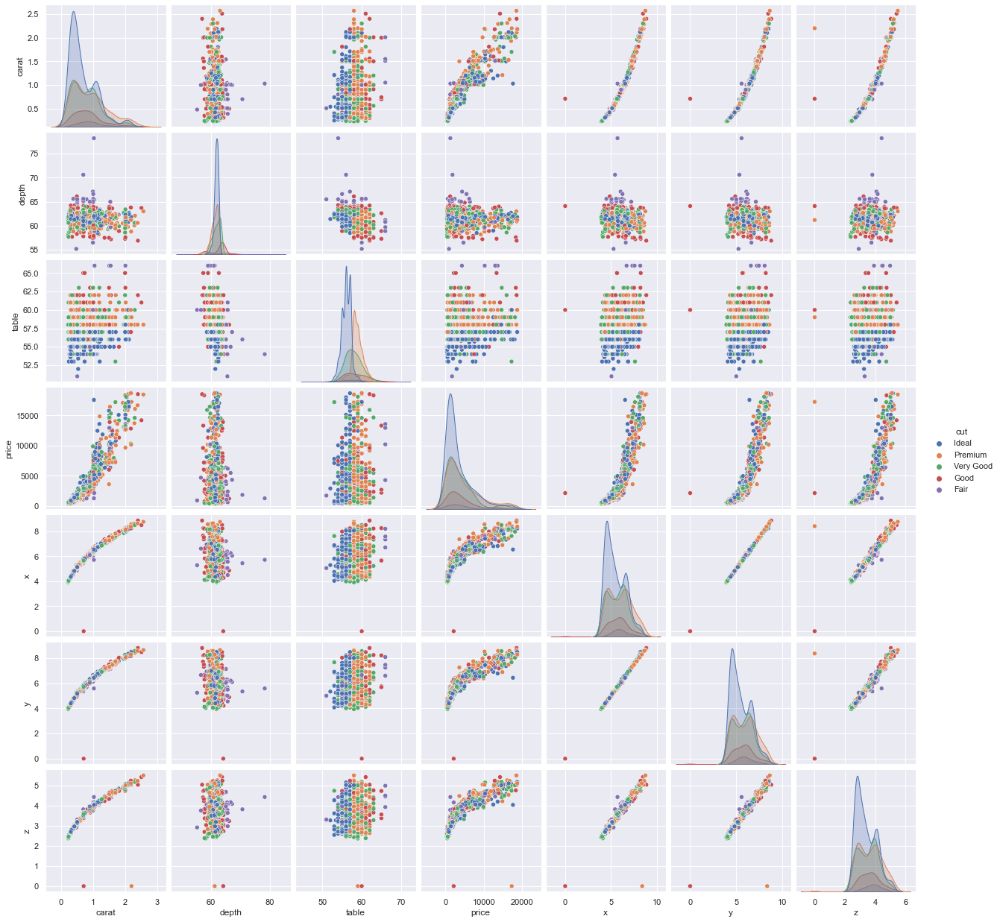

In [124]:
sns.pairplot(d.sample(1000), hue='cut');

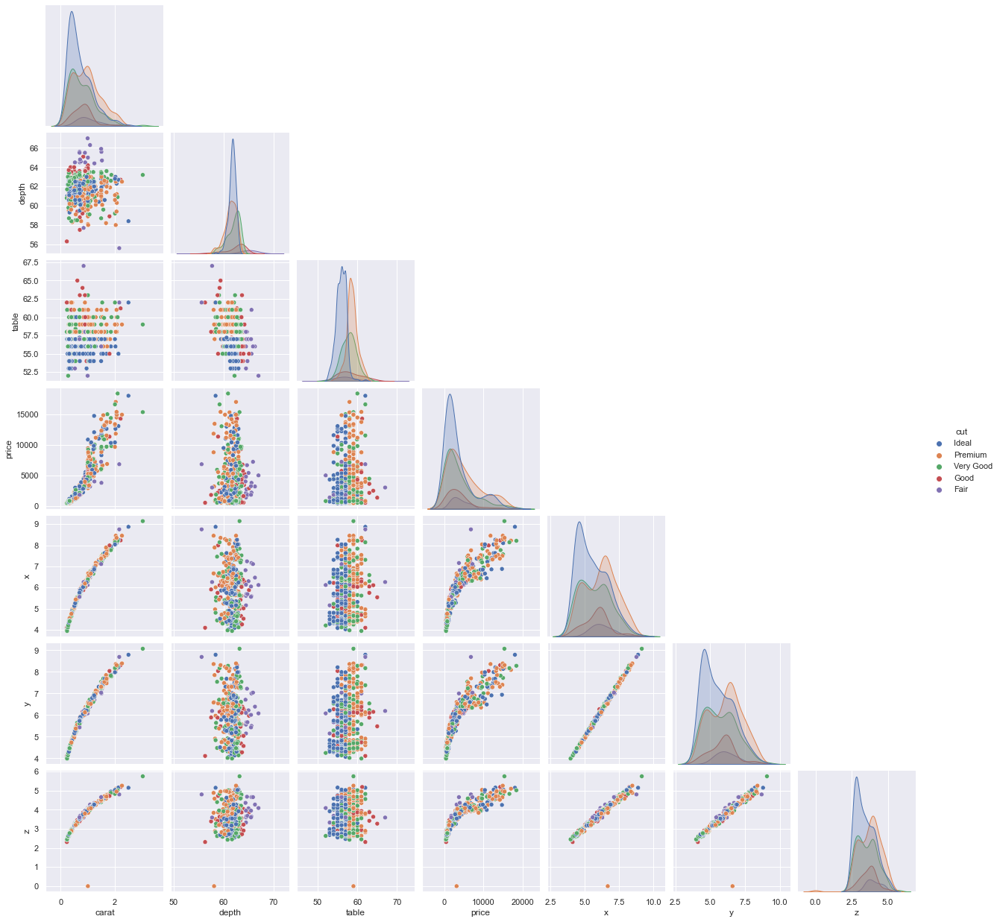

In [125]:
sns.pairplot(d.sample(500), hue = 'cut', corner=True); #removes excess plots